In [1]:
import geopandas as gpd


In [2]:
gdf = gpd.read_file('/home/jovyan/isce_sat2/data/uavsar_shape_files/uticam_21003_21004-002_21013-003_0034d_s01_L090HH_01.cor.grd .shp')

In [3]:
gdf2 = gpd.read_file('/home/jovyan/isce_sat2/data/uavsar_shape_files/stlake_27129_21020-024_21022-001_0006d_s01_L090HH_01.cor.grd .shp')




In [4]:
file = 'stlake_27129_21020-024_21022-00'

name = file.split('_')[0]
name

'stlake'

In [5]:
gdf.head()

,FID,geometry
0,0,"POLYGON ((-109.94546 47.25411, -109.94541 47.2..."


In [9]:
gdf['site'] = name

In [8]:
gdf

,FID,geometry,site
0,0,"POLYGON ((-109.94546 47.25411, -109.94541 47.2...",stlake


In [17]:
gdf2.head()

,FID,geometry
0,0,"POLYGON ((-111.89028 40.72331, -111.89006 40.7..."


In [10]:
gdf2.columns

Index(['FID', 'geometry', 'site'], dtype='object')

In [34]:
ab = gdf.concat(gdf2)

AttributeError: 'GeoDataFrame' object has no attribute 'concat'

<AxesSubplot:>

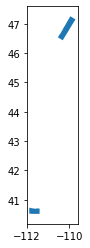

In [15]:
a.plot()

<AxesSubplot:>

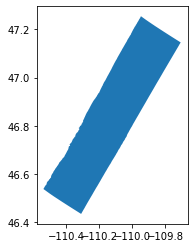

In [5]:
gdf.plot()

In [7]:
import folium

In [17]:
import os
import glob

path = '/home/jovyan/isce_sat2/data/uavsar_shape_files/'
extension = 'shp'
os.chdir(path)
result = glob.glob('*.{}'.format(extension))
print(result)

['grmesa_27416_21019-017_21021-005_0006d_s01_L090HH_01.cor.grd .shp', 'donner_03904_20014-003_20016-007_0014d_s01_L090HH_01.cor.grd .shp', 'silver_34715_20011-001_20016-002_0019d_s01_L090HH_01.cor.grd .shp', 'irnton_01406_21020-028_21022-002_0006d_s01_L090HH_01.cor.grd .shp', 'uticam_21003_21004-002_21013-003_0034d_s01_L090HH_01.cor.grd .shp', 'dorado_34017_20014-002_20016-000_0014d_s01_L090HH_01.cor.grd .shp', 'alamos_35915_20005-003_20008-000_0007d_s01_L090HH_01.cor.grd .shp', 'lowman_05208_21019-019_21021-007_0006d_s01_L090HH_01.cor.grd .shp', 'peeler_31619_20013-003_20017-008_0015d_s01_L090HH_01.cor.grd .shp', 'stlake_27129_21020-024_21022-001_0006d_s01_L090HH_01.cor.grd .shp', 'fraser_23306_21020-026_21021-004_0006d_s01_L090HH_01.cor.grd .shp', 'sierra_17305_20014-000_20016-005_0014d_s01_L090HH_01.cor.grd .shp', 'rockmt_32109_21017-013_21021-001_0012d_s01_L090HH_01.cor.grd .shp']


In [31]:
final_gdf = gpd.GeoDataFrame(columns=['FID', 'geometry', 'site_name'])

In [37]:
for file in result:
    dir = '/home/jovyan/isce_sat2/data/uavsar_shape_files/'
    path = dir + file
    #print(path)
    temp = gpd.read_file(path)
    
    temp['site_name'] = file.split('_')[0]
    
    final_gdf = final_gdf.append(temp)
    

/tmp/ipykernel_1763/2413716312.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  final_gdf = final_gdf.append(temp)
/tmp/ipykernel_1763/2413716312.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  final_gdf = final_gdf.append(temp)
/tmp/ipykernel_1763/2413716312.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  final_gdf = final_gdf.append(temp)
/tmp/ipykernel_1763/2413716312.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  final_gdf = final_gdf.append(temp)
/tmp/ipykernel_1763/2413716312.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  

In [38]:
final_gdf

,FID,geometry,site_name
0,0,"POLYGON ((-108.25922 39.16208, -108.25899 39.1...",grmesa
0,0,"POLYGON ((-120.31301 39.53100, -120.31290 39.5...",donner
0,0,"POLYGON ((-116.66028 43.35102, -116.66022 43.3...",silver
0,0,"POLYGON ((-107.79512 38.09210, -107.79496 38.0...",irnton
0,0,"POLYGON ((-109.94546 47.25411, -109.94541 47.2...",uticam
0,0,"POLYGON ((-120.38335 39.65517, -120.38319 39.6...",dorado
0,0,"POLYGON ((-106.33006 36.09961, -106.32989 36.0...",alamos
0,0,"MULTIPOLYGON (((-115.02531 44.48039, -115.0253...",lowman
0,0,"POLYGON ((-107.03540 39.18947, -107.03506 39.1...",peeler
0,0,"POLYGON ((-111.89028 40.72331, -111.89006 40.7...",stlake


<AxesSubplot:>

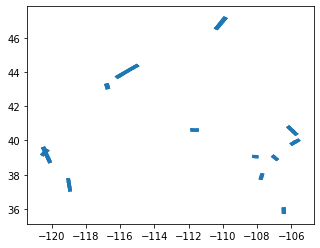

In [39]:
final_gdf.plot()

In [47]:
final_gdf = final_gdf.set_crs('epsg:4326')

In [48]:
print(final_gdf.crs)

epsg:4326


In [50]:
import folium
m = folium.Map(tiles='openstreetmap')
folium.GeoJson(final_gdf["geometry"]).add_to(m)
m